# **Análise Correlacional - Susp. Dengue / Rend. Dom. per capita**

In [ ]:
df_combined = pd.merge(dengue_dict, renda_dict, on='Município')
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
y = df_combined['Suspeitas_por_1000_hab']
x = df_combined['Renda_média_domic._per_capita']

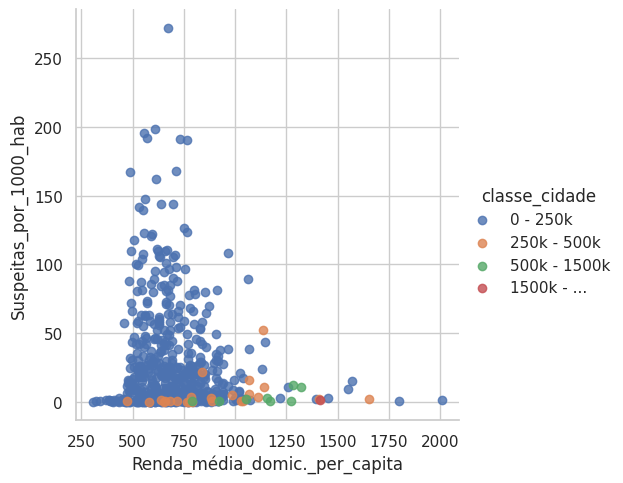

In [ ]:
sns.lmplot(x='Renda_média_domic._per_capita', y='Suspeitas_por_1000_hab', data=df_combined, hue='classe_cidade', fit_reg=False)

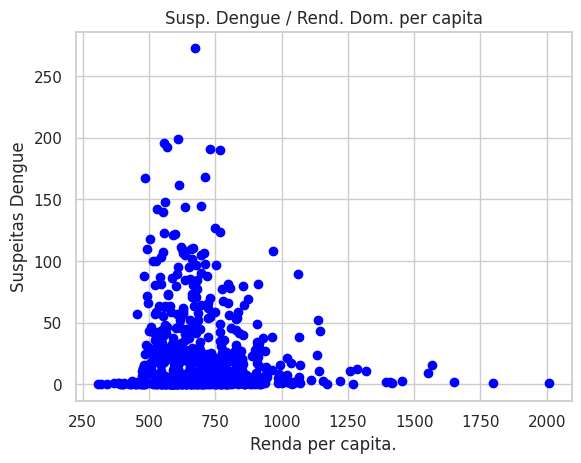

In [ ]:
plt.scatter(x, y, c ="blue")
plt.xlabel("Renda per capita.")
plt.ylabel("Suspeitas Dengue")
plt.title('Susp. Dengue / Rend. Dom. per capita')
plt.show()

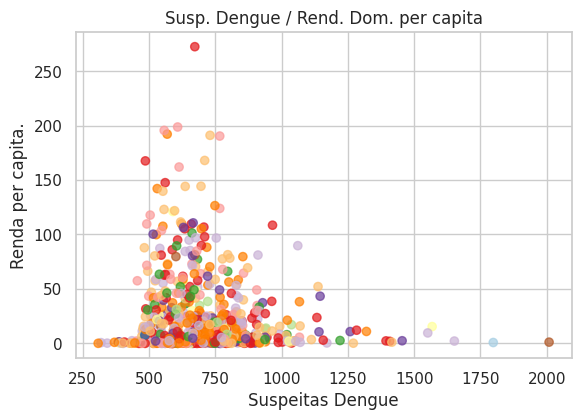

In [ ]:
import random
import matplotlib.cm as cm
fig = plt.figure()
fig.subplots_adjust(bottom=0.2)
ax = fig.add_subplot(111)

dS=np.random.normal(size=616)

idx=random.sample(range(616),616)

plt.xlabel("Suspeitas Dengue")
plt.ylabel("Renda per capita.")
plt.title('Susp. Dengue / Rend. Dom. per capita')
plt.scatter(x,y,c=dS[idx],alpha=0.7,cmap=cm.Paired)
plt.show()

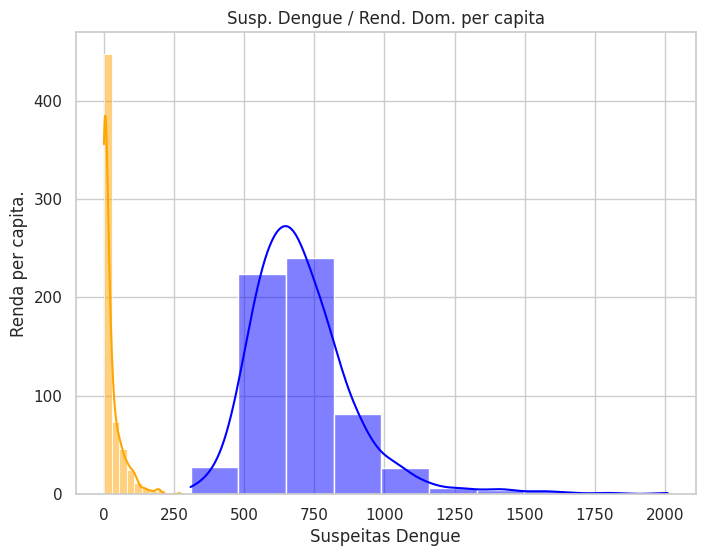

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))

sns.histplot(x, bins=10, kde=True, label='Suspeitas Dengue', color='blue')
sns.histplot(y, bins=10, kde=True, label='Renda per capita.', color='orange')

plt.xlabel("Suspeitas Dengue")
plt.ylabel("Renda per capita.")
plt.title('Susp. Dengue / Rend. Dom. per capita')
# Exibir o gráfico
plt.show()

# **Análise Correlacional - Dist. Médicos / IDH**

In [ ]:
IDHM = pd.read_excel("data.xlsx")
IDHM = IDHM.dropna()
IDHM.rename(columns={'Territorialidades': 'Município'}, inplace=True)
IDHM['Município'] = IDHM['Município'].str.replace(r'\s*\(SP\)', '', regex=True)
IDHM = IDHM.drop(0)

In [ ]:
IDHM['IDHM 2010'].mean()

0.7395271317829464

In [ ]:
def mapear_codigo_ibge(nome_cidade): #Função para substituir o nome pelo código IBGE do município
    for s in sp_cities['features']:
      try:
        if(s['properties']['name'] == nome_cidade):
          codigo_ibge = s['properties']['id']
          return codigo_ibge
      except KeyError:
            return None  # Retorne None se o nome da cidade não for encontrado no GeoJSON



In [ ]:
IDHM['Município'] = IDHM['Município'].apply(mapear_codigo_ibge)
idhm_dict = IDHM.set_index('Município')

In [ ]:
df_combined = pd.merge(idhm_dict, medicos_dict, on='Município')
df_combined = df_combined.drop('Total', axis=1)

In [ ]:
df_combined['IDHM 2010'] = df_combined['IDHM 2010'].astype(float)
correlation = df_combined.corr()
correlation

,IDHM 2010,IDHM Renda 2010,IDHM Longevidade 2010,IDHM Educação 2010,censo2022,Medicos_por_1000_hab
IDHM 2010,1.000000,0.882290,0.687178,0.899558,0.185812,0.453908
IDHM Renda 2010,0.882290,1.000000,0.591014,0.628862,0.233914,0.461430
IDHM Longevidade 2010,0.687178,0.591014,1.000000,0.441199,0.097934,0.360700
IDHM Educação 2010,0.899558,0.628862,0.441199,1.000000,0.127906,0.347022
censo2022,0.185812,0.233914,0.097934,0.127906,1.000000,0.168420
Medicos_por_1000_hab,0.453908,0.461430,0.360700,0.347022,0.168420,1.000000


In [ ]:
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

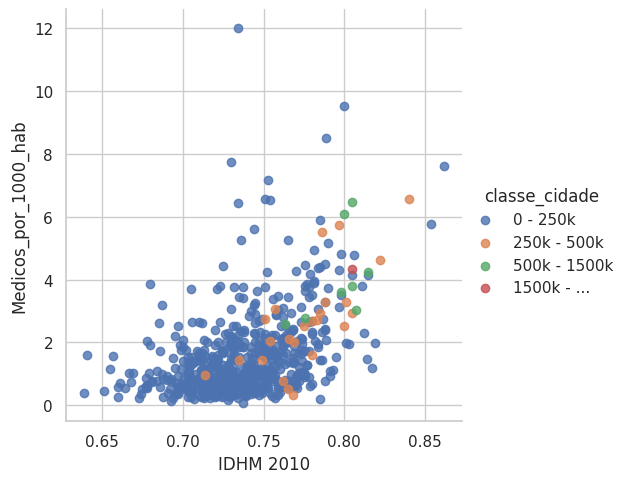

In [ ]:
sns.lmplot(x='IDHM 2010', y='Medicos_por_1000_hab', data=df_combined, hue='classe_cidade', fit_reg=False)

# **Análise Correlacional - Dist. Médicos / Estabelecimentos**

In [ ]:
df_combined = pd.merge(estabelecimentos_dict, medicos_dict, on='Município')
colunas = ['Estabelecimentos_por_1000_hab', 'Medicos_por_1000_hab', 'censo2022_x', 'Total_x']
df_combined = df_combined[colunas]
df_combined = df_combined.rename(columns={'censo2022_x': 'censo2022', 'Total_x': 'Total'})
x = df_combined['Estabelecimentos_por_1000_hab']
y = df_combined['Medicos_por_1000_hab']
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
correlation = df_combined.corr()
correlation

<ipython-input-154-db6e5524fe44>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = df_combined.corr()


,Estabelecimentos_por_1000_hab,Medicos_por_1000_hab,censo2022,Total
Estabelecimentos_por_1000_hab,1.000000,0.339725,0.009572,0.128232
Medicos_por_1000_hab,0.339725,1.000000,0.168131,0.244957
censo2022,0.009572,0.168131,1.000000,0.978438
Total,0.128232,0.244957,0.978438,1.000000


In [ ]:
df_combined['Correlacao'] = df_combined['Estabelecimentos_por_1000_hab']*df_combined['Medicos_por_1000_hab']

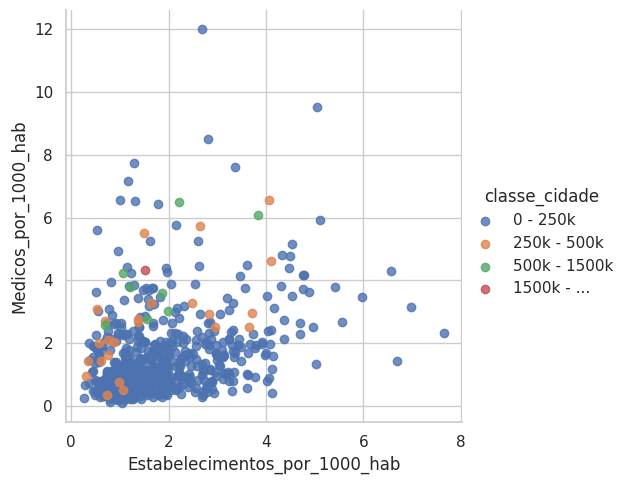

In [ ]:
sns.lmplot(x='Estabelecimentos_por_1000_hab', y='Medicos_por_1000_hab', data=df_combined, hue='classe_cidade', fit_reg=False)

# **Análise Correlacional - Deslocamento / Estabelecimentos**

In [ ]:
df_combined = pd.merge(df_deslocamento_dict, estabelecimentos_dict, on='Município')
colunas = ['Estabelecimentos_por_1000_hab', 'Balança', 'censo2022', 'Total']
df_combined = df_combined[colunas]
x = df_combined['Estabelecimentos_por_1000_hab']
y = df_combined['Balança']
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)
#df_combined['classe_cidade_ibge'] = df_combined['censo2022'].apply(calcular_classe_ibge)
#df_combined['classe_cidade_ibge'] = df_combined['classe_cidade_ibge'].map(mapper_ibge)

In [ ]:
correlation = df_combined.corr()
correlation

<ipython-input-172-db6e5524fe44>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = df_combined.corr()


,Estabelecimentos_por_1000_hab,Balança,censo2022,Total
Estabelecimentos_por_1000_hab,1.000000,0.165839,0.012966,0.131180
Balança,0.165839,1.000000,0.756754,0.827724
censo2022,0.012966,0.756754,1.000000,0.978433
Total,0.131180,0.827724,0.978433,1.000000


In [ ]:
df_combined = df_combined.drop('355030', axis=0) #Retirar São Paulo

In [ ]:
# Deslocamento x Estabelecimentos
sns.lmplot(x='Estabelecimentos_por_1000_hab', y='Balança', data=df_combined, hue='classe_cidade', fit_reg=True)
#df_combined = df_combined.drop('355030', axis=0) #Retirar São Paulo
sns.lmplot(x='Total', y='Balança', data=df_combined, hue='classe_cidade', fit_reg=True)
# Deslocamento x População
sns.lmplot(x='censo2022', y='Balança', data=df_combined, hue='classe_cidade', fit_reg=False)

In [ ]:
df_internacoes_estab = pd.merge(df_deslocamento_dict, estabelecimentos_dict, on='Município')
colunas = ['Balança', 'Internação', 'classe', 'Total']
df_internacoes_estab = df_internacoes_estab[colunas]

In [ ]:
df_internacoes_estab['internacoes_por_estabelecimento'] = df_internacoes_estab['Internação'].div(df_internacoes_estab['Total']).round(2)
df_internacoes_estab = df_internacoes_estab.reset_index()

In [ ]:
correlation = df_internacoes_estab.corr()
correlation

<ipython-input-95-104e6d5803dc>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = df_internacoes_estab.corr()


,Balança,Internação,Total,internacoes_por_estabelecimento
Balança,1.000000,0.840444,0.827724,0.190799
Internação,0.840444,1.000000,0.986262,0.162183
Total,0.827724,0.986262,1.000000,0.106501
internacoes_por_estabelecimento,0.190799,0.162183,0.106501,1.000000


# **Análise Correlacional - Deslocamento / IDH**

In [ ]:
df_combined = pd.merge(df_deslocamento_dict, idhm_dict, on='Município')
df_combined = pd.merge(df_combined, PopSp2022, left_on='Município', right_on='cod_ibge')
colunas = ['IDHM 2010', 'Balança', 'censo2022']
df_combined = df_combined[colunas]
x = df_combined['IDHM 2010']
y = df_combined['Balança']
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
df_combined['IDHM 2010'] = df_combined['IDHM 2010'].astype(float)
correlation = df_combined.corr()
correlation

<ipython-input-206-0461af15c2a8>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = df_combined.corr()


,IDHM 2010,Balança,censo2022
IDHM 2010,1.000000,0.242424,0.185551
Balança,0.242424,1.000000,0.756802
censo2022,0.185551,0.756802,1.000000


In [ ]:
df_filtrado = df_combined[df_combined['censo2022'] > 250000].copy()
correlation2 = df_filtrado.corr()
correlation2

<ipython-input-208-28db0495d121>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation2 = df_filtrado.corr()


,IDHM 2010,Balança,censo2022
IDHM 2010,1.000000,0.525593,0.190369
Balança,0.525593,1.000000,0.783436
censo2022,0.190369,0.783436,1.000000


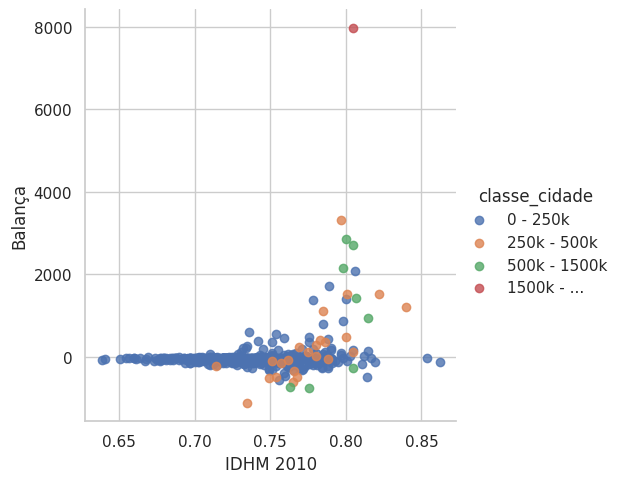

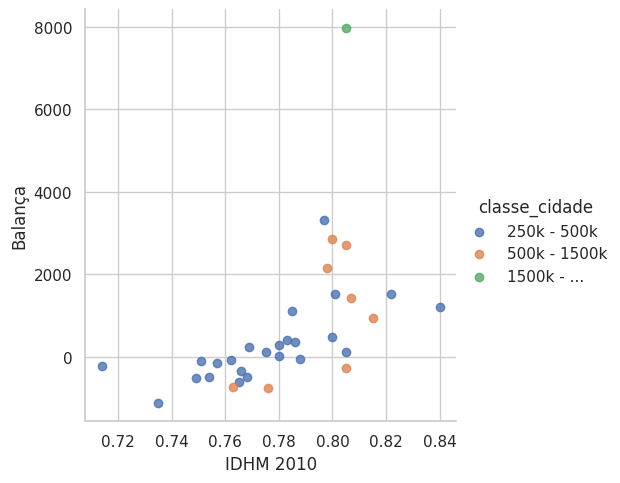

In [ ]:
sns.lmplot(x='IDHM 2010', y='Balança', data=df_combined, hue='classe_cidade', fit_reg=False)
sns.lmplot(x='IDHM 2010', y='Balança', data=df_filtrado, hue='classe_cidade', fit_reg=False)

# **Mapa - Tipos de especialista**

In [ ]:
medicos = copy.deepcopy(medicos_municipio)
medicos = medicos.replace('-', '0')
medicos.columns = medicos.columns.str.replace('^ ', '', regex=True)

In [ ]:
pop = copy.deepcopy(PopSp2022)
colunas = ['cod_ibge', 'censo2022']
pop = pop[colunas]

In [ ]:
# Mesclar os DataFrames
especialista_hab = pd.merge(pop, medicos, left_on='cod_ibge', right_on='Município')
especialista_hab = especialista_hab.astype(float)
# Divida todas as colunas pelos valores da coluna de divisão
especialista_hab.iloc[:, 3:] = especialista_hab.iloc[:, 3:].div((especialista_hab['censo2022'] / 1000), axis=0).round(2)
#Altera e remove as colunas iniciais
especialista_hab.iloc[:, :3] = especialista_hab.iloc[:, :3].astype(int).astype(object)
especialista_hab = especialista_hab.iloc[:, 2:]
especialista_hab = especialista_hab.replace(0, np.nan)

In [ ]:
especialistas_dict = especialista_hab.set_index('Município')
especialistas_dict.index = especialistas_dict.index.astype(str)

In [ ]:
def filtrar_especialista(especialidade, mapa):
  for s in mapa.geojson.data['features']:
    try:
      s['properties'][especialidade] = especialistas_dict.loc[s['properties']['id'], especialidade]
    except KeyError:
      s['properties'][especialidade] = None

In [ ]:
from folium import plugins
import ipywidgets as widgets
from ipywidgets import interact

# Cria uma lista de especialidades únicas a partir dos nomes das colunas do DataFrame
especialidades = medicos.columns[1:]
geoData = copy.deepcopy(sp_cities)

# Função para filtrar e exibir o mapa com base na especialidade selecionada
def filtrar_mapa(especialidade):

  map = folium.Map(
  location=[-23.6814347,-46.9249399],
  zoom_start=7)

  mapData = folium.Choropleth(
  geo_data=geoData,
  name='choropleth',
  data=especialista_hab,
  columns=['Município', especialidade],
  key_on='feature.properties.id',
  fill_color='YlOrRd',
  fill_opacity=1,
  line_opacity=0.2,
  smooth_factor=0,
  use_jenks=True,
  Highlight= False,
  Name= 'Médicos',
  line_color = "Black",
  show=False,
  overlay=False,
  nan_fill_color = "White",
  legend_name='Quantidade de profissionais'
  ).add_to(map)

  filtrar_especialista(especialidade, mapData)

  highlight_function = lambda x: {'fillColor': '#000000',
                              'color':'#000000',
                              'fillOpacity': 0.50,
                              'weight': 0.1}
  style_function = lambda x: {
    'color' : 'white',
    'opacity' : 0,
    'weight' : '2'
  }
  map_style = folium.features.GeoJson(
      mapData.geojson.data,
      control=False,
      style_function = style_function,
      highlight_function=highlight_function,
      tooltip=folium.features.GeoJsonTooltip(
          fields=['name', especialidade],
          aliases=['Município: ','Quantidade'],
          style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
      )
  )
  map.add_child(map_style)
  folium.LayerControl().add_to(map)

  mapData = folium.Choropleth(
  geo_data=geoData,
  name='choropleth',
  data=especialista_hab,
  columns=['Município', especialidade],
  key_on='feature.properties.id',
  fill_color='YlOrRd',
  fill_opacity=1,
  line_opacity=0.2,
  smooth_factor=0,
  use_jenks=True,
  Highlight= False,
  Name= 'Médicos',
  line_color = "Black",
  show=False,
  overlay=False,
  nan_fill_color = "White",
  legend_name='Quantidade médicos'
  ).add_to(map)

  display(map)

# Cria um widget interativo para selecionar a especialidade
especialidade_widget = widgets.Dropdown(
  options=especialidades,
  description='Especialidade:'
)
# Cria uma função interativa para atualizar o mapa quando a especialidade for selecionada
interact(filtrar_mapa, especialidade=especialidade_widget)


interactive(children=(Dropdown(description='Especialidade:', options=('Anestesiologista', 'Cirurgião Geral', '…

<function __main__.filtrar_mapa(especialidade)>

# **Mapa - Tipos de estabelecimento**

In [ ]:
estabelecimentos = copy.deepcopy(estabelecimentos_municipio)
estabelecimentos = estabelecimentos.replace('-', '0')

In [ ]:
pop = copy.deepcopy(PopSp2022)
colunas = ['cod_ibge', 'censo2022']
pop = pop[colunas]

In [ ]:
# Mesclar os DataFrames
estab_hab = pd.merge(pop, estabelecimentos, left_on='cod_ibge', right_on='Município')
estab_hab = estab_hab.astype(float)
# Divida todas as colunas pelos valores da coluna de divisão
estab_hab.iloc[:, 3:] = estab_hab.iloc[:, 3:].div((estab_hab['censo2022'] / 1000), axis=0).round(2)
#Altera e remove as colunas iniciais
estab_hab.iloc[:, :3] = estab_hab.iloc[:, :3].astype(int).astype(object)
estab_hab = estab_hab.iloc[:, 2:]

In [ ]:
estab_dict = estab_hab.set_index('Município')
estab_dict.index = estab_dict.index.astype(str)

In [ ]:
def filtrar_especialista(tipo_estabelecimento, mapa):
  for s in mapa.geojson.data['features']:
    try:
      s['properties'][tipo_estabelecimento] = estab_dict.loc[s['properties']['id'], tipo_estabelecimento]
    except KeyError:
      s['properties'][tipo_estabelecimento] = None

In [ ]:
from folium import plugins
import ipywidgets as widgets
from ipywidgets import interact

# Cria uma lista de especialidades únicas a partir dos nomes das colunas do DataFrame
nomes_tipo_estabelecimento = estabelecimentos.columns[1:]
geoData = copy.deepcopy(sp_cities)

# Função para filtrar e exibir o mapa com base no tipo_estabelecimento selecionado
def filtrar_mapa(tipo_estabelecimento):

  map = folium.Map(
  location=[-23.6814347,-46.9249399],
  zoom_start=7)

  mapData = folium.Choropleth(
  geo_data=geoData,
  name='choropleth',
  data=estab_hab,
  columns=['Município', tipo_estabelecimento],
  key_on='feature.properties.id',
  fill_color='YlOrBr',
  fill_opacity=1,
  line_opacity=0.2,
  smooth_factor=0,
  Highlight= False,
  Name= 'Médicos',
  line_color = "Black",
  show=False,
  overlay=False,
  nan_fill_color = "White",
  legend_name='Quantidade de profissionais'
  ).add_to(map)

  filtrar_especialista(tipo_estabelecimento, mapData)

  highlight_function = lambda x: {'fillColor': '#000000',
                              'color':'#000000',
                              'fillOpacity': 0.50,
                              'weight': 0.1}
  style_function = lambda x: {
    'color' : 'white',
    'opacity' : 0,
    'weight' : '2'
  }
  map_style = folium.features.GeoJson(
      mapData.geojson.data,
      control=False,
      style_function = style_function,
      highlight_function=highlight_function,
      tooltip=folium.features.GeoJsonTooltip(
          fields=['name', tipo_estabelecimento],
          aliases=['Município: ','Quantidade'],
          style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
      )
  )
  map.add_child(map_style)
  folium.LayerControl().add_to(map)

  mapData = folium.Choropleth(
  geo_data=geoData,
  name='choropleth',
  data=estab_hab,
  columns=['Município', tipo_estabelecimento],
  key_on='feature.properties.id',
  fill_color='YlOrBr',
  fill_opacity=1,
  line_opacity=0.2,
  smooth_factor=0,
  Highlight= False,
  Name= 'Médicos',
  line_color = "Black",
  show=False,
  overlay=False,
  nan_fill_color = "White",
  legend_name='Quantidade médicos'
  ).add_to(map)

  display(map)

# Cria um widget interativo para selecionar o tipo_estabelecimento
estabelecimento_widget = widgets.Dropdown(
  options=nomes_tipo_estabelecimento,
  description='Estabelecimento:'
)
# Cria uma função interativa para atualizar o mapa quando o estabelecimento for selecionada
interact(filtrar_mapa, tipo_estabelecimento=estabelecimento_widget)


interactive(children=(Dropdown(description='Estabelecimento:', options=('POSTO DE SAUDE', 'CENTRO DE SAUDE/UNI…

<function __main__.filtrar_mapa(tipo_estabelecimento)>

# **Mapa - Estabelecimento por prestador**

In [ ]:
estab_prestador = pd.DataFrame(pd.read_csv('Estabelecimentos_prestador_municipio.csv', encoding = 'latin-1', sep=';', on_bad_lines='skip'))

In [ ]:
estab_prestador['Município'] = estab_prestador['Município'].str.replace('\D', '').str.replace(' ', '')
estab_prestador = estab_prestador.dropna(axis=0)
estab_prestador = estab_prestador.replace('-', '0')

<ipython-input-34-fb0563435df8>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  estab_prestador['Município'] = estab_prestador['Município'].str.replace('\D', '').str.replace(' ', '')


In [ ]:
pop = copy.deepcopy(PopSp2022)
colunas = ['cod_ibge', 'censo2022']
pop = pop[colunas]

In [ ]:
# Mesclar os DataFrames
estab_prestador_hab = pd.merge(pop, estab_prestador, left_on='cod_ibge', right_on='Município')
estab_prestador_hab = estab_prestador_hab.astype(float)
# Divida todas as colunas pelos valores da coluna de divisão
estab_prestador_hab.iloc[:, 3:] = estab_prestador_hab.iloc[:, 3:].div((estab_prestador_hab['censo2022'] / 1000), axis=0).round(2)
#Altera e remove as colunas iniciais
estab_prestador_hab.iloc[:, :3] = estab_prestador_hab.iloc[:, :3].astype(int).astype(object)
estab_prestador_hab = estab_prestador_hab.iloc[:, 2:]

In [ ]:
estab_prestador_dict = estab_prestador_hab.set_index('Município')
estab_prestador_dict.index = estab_prestador_dict.index.astype(str)

In [ ]:
def filtrar_especialista(tipo_prestador, mapa):
  for s in mapa.geojson.data['features']:
    try:
      s['properties'][tipo_prestador] = estab_prestador_dict.loc[s['properties']['id'], tipo_prestador]
    except KeyError:
      s['properties'][tipo_prestador] = None

In [ ]:
from folium import plugins
import ipywidgets as widgets
from ipywidgets import interact

# Cria uma lista de especialidades únicas a partir dos nomes das colunas do DataFrame
prestadores = estab_prestador.columns[1:]
geoData = copy.deepcopy(sp_cities)

# Função para filtrar e exibir o mapa com base no tipo_prestador selecionado
def filtrar_mapa(tipo_prestador):

  map = folium.Map(
  location=[-23.6814347,-46.9249399],
  zoom_start=7)

  mapData = folium.Choropleth(
  geo_data=geoData,
  name='choropleth',
  data=estab_prestador_hab,
  columns=['Município', tipo_prestador],
  key_on='feature.properties.id',
  fill_color='YlOrRd',
  fill_opacity=1,
  line_opacity=0.2,
  smooth_factor=0,
  Highlight= False,
  Name= 'Estabelecimentos',
  line_color = "Black",
  show=False,
  overlay=False,
  nan_fill_color = "White",
  legend_name='Quantidade estabelecimentos por 1000 habitantes'
  ).add_to(map)

  filtrar_especialista(tipo_prestador, mapData)

  highlight_function = lambda x: {'fillColor': '#000000',
                              'color':'#000000',
                              'fillOpacity': 0.50,
                              'weight': 0.1}
  style_function = lambda x: {
    'color' : 'white',
    'opacity' : 0,
    'weight' : '2'
  }
  map_style = folium.features.GeoJson(
      mapData.geojson.data,
      control=False,
      style_function = style_function,
      highlight_function=highlight_function,
      tooltip=folium.features.GeoJsonTooltip(
          fields=['name', tipo_prestador],
          aliases=['Município: ','Quantidade'],
          style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
      )
  )
  map.add_child(map_style)
  folium.LayerControl().add_to(map)

  mapData = folium.Choropleth(
  geo_data=geoData,
  name='choropleth',
  data=estab_prestador_hab,
  columns=['Município', tipo_prestador],
  key_on='feature.properties.id',
  fill_color='YlOrRd',
  fill_opacity=1,
  line_opacity=0.2,
  smooth_factor=0,
  Highlight= False,
  Name= 'Estabelecimentos',
  line_color = "Black",
  show=False,
  overlay=False,
  nan_fill_color = "White",
  legend_name='Quantidade estabelecimentos por 1000 habitantes'
  ).add_to(map)

  display(map)

# Cria um widget interativo para selecionar o tipo_prestador
prestador_widget = widgets.Dropdown(
  options=prestadores,
  description='Prestador:'
)
# Cria uma função interativa para atualizar o mapa quando o prestador for selecionado
interact(filtrar_mapa, tipo_prestador=prestador_widget)


interactive(children=(Dropdown(description='Prestador:', options=('Público', 'Filantropico', 'Privado', 'Sindi…

<function __main__.filtrar_mapa(tipo_prestador)>

# **Análise Correlacional - Correlação Geral**

In [ ]:
df_combined = pd.merge(medicos_dict, renda_dict, on='Município').merge(estabelecimentos_dict, on='Município').merge(despesa_dict, on='Município').merge(idhm_dict, on='Município').merge(estab_prestador_dict, on='Município').merge(df_deslocamento_dict, on='Município')

In [ ]:
df_combined

In [ ]:
df_combined['IDHM 2010'] = df_combined['IDHM 2010'].astype(float)
colunas_para_remover = ['Total_y', 'censo2022_y', 'Total_x', 'censo2022_x', 'Filantropico', 'Sindicato']
df_combined = df_combined.drop(columns=colunas_para_remover)
correlation_pearson = df_combined.corr(method= 'pearson')
correlation_kendall = df_combined.corr(method= 'kendall')
correlation_spearman = df_combined.corr(method= 'spearman')

In [ ]:
correlation_pearson

In [ ]:
#Maior correlação entre os métodos em relação a Distribuição de médicos foi com a Renda média domiciliar per capita
print("Método de Pearson:", correlation_pearson.iloc[1, 0])
print("Método de Kendall:", correlation_kendall.iloc[1, 0])
print("Método de Spearman:", correlation_spearman.iloc[1, 0])

In [ ]:
df_combined

In [ ]:
df_combined_plot = df_combined.iloc[:, [1, 2, 3, 6, 9, 12, 13, 17, 19]]
df_combined_plot['classe_cidade'] = df_combined_plot['censo2022_x'].apply(calcular_classe)
df_combined_plot['classe_cidade'] = df_combined_plot['classe_cidade'].map(mapper)
df_combined_plot = df_combined_plot.drop(columns='censo2022_x')

In [ ]:
df_combined_plot = df_combined_plot.rename(columns={'Medicos_por_1000_hab': 'Médicos', 'Renda_média_domic._per_capita': 'Renda per capita', 'Estabelecimentos_por_1000_hab': 'Estabelecimentos', 'Valor_por_1000_hab': 'Valor gasto', 'Suspeitas_por_1000_hab': 'Suspeitas dengue',})

In [ ]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

sns.pairplot(df_combined_plot, hue="classe_cidade", kind="scatter", markers=["o", "s", "D"])

plt.legend('Valores para 1000 habitantes, exceto renda domiciliar per capita')
plt.show()

# **Dados Saúde - Morbidade por local Residência/internação - 2023**

In [ ]:
residencia = pd.read_csv('Morbidade_residencia.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')
internação = pd.read_csv('Morbidade_internação.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')

residencia['Município'] = residencia['Município'].str.replace('\D', '').str.replace(' ', '')
internação['Município'] = internação['Município'].str.replace('\D', '').str.replace(' ', '')

residencia = residencia.dropna(axis=0)
internação = internação.dropna(axis=0)

In [ ]:
residencia_dict = residencia.set_index('Município')
internação_dict = internação.set_index('Município')

In [ ]:
df_deslocamento = pd.merge(residencia_dict, internação_dict, on='Município', how='left')
df_deslocamento = df_deslocamento.fillna(0)
df_deslocamento = df_deslocamento.rename(columns={'Internações_x': 'Residência', 'Internações_y': 'Internação'})
df_deslocamento['Balança'] = df_deslocamento['Internação'] - df_deslocamento['Residência']
df_deslocamento.reset_index(inplace=True)
df_deslocamento_dict = df_deslocamento.set_index('Município')
# Balança positiva: Pacientes vieram até a cidade
# Balança negativa: Pacientes saíram da cidade

In [ ]:
df_deslocamento['classe'] = df_deslocamento['Balança'].apply(calcular_balanca_internacoes)
df_deslocamento['classe'] = df_deslocamento['classe'].map(mapper_internacoes)
df_deslocamento_dict = df_deslocamento.set_index('Município')

In [ ]:
df_deslocamento_dict['%'] = (df_deslocamento_dict['Balança'].div(df_deslocamento_dict['Internação'])*100).round(2)

In [ ]:
df_combined = pd.merge(idhm_dict, renda_dict, on='Município').merge(df_deslocamento_dict, on='Município').merge(estabelecimentos_dict, on='Município')

In [ ]:
df_combined['IDHM 2010'] = df_combined['IDHM 2010'].astype(float)
colunas = ['Balança','IDHM 2010', 'Renda_média_domic._per_capita', 'censo2022' ]
df_combined = df_combined[colunas]

In [ ]:
maiores_taxas_despesa = df_combined.sort_values(by='Balança', ascending=False)

In [ ]:
maiores_taxas_despesa.head(10)

In [ ]:
maiores_taxas_despesa['Balança'].head(10).mean()

In [ ]:
df_porcentagem_deslocamento = df_deslocamento_dict[df_deslocamento_dict['%'] > 0].copy()

In [ ]:
df_porcentagem_deslocamento.describe().round(2)

In [ ]:
df_combined = pd.merge(df_deslocamento_dict, medicos_dict, on='Município')
colunas_para_remover = ['Total']
df_combined = df_combined.drop(columns=colunas_para_remover)
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
correlation = df_combined.corr()
correlation

In [ ]:
df_Pop250k = df_combined[df_combined['censo2022'] > 250000].copy()
correlationPop = df_filtrado.corr()
correlationPop

In [ ]:
df_combined.reset_index(inplace= True)
mascara = df_combined['Município'] != "355030" # Remove a cidade de São Paulo
df_combined = df_combined[mascara]
df_combined.set_index('Município', inplace= True)

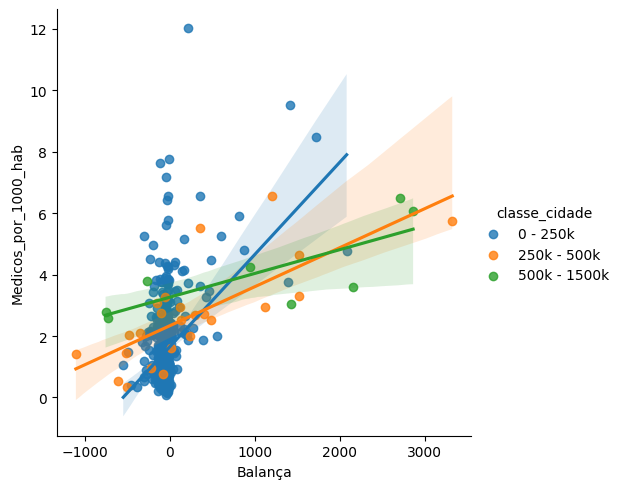

In [ ]:
sns.lmplot(x='Balança', y='Medicos_por_1000_hab', data=df_combined, hue='classe_cidade', fit_reg=True)
#sns.lmplot(x='Balança', y='Medicos_por_1000_hab', data=df_filtrado, hue='classe_cidade', fit_reg=True)

In [ ]:
plotMap(df_deslocamento, 'Município', 'Balança', 'Balanço de internações', df_deslocamento_dict)

In [ ]:
def getcolor(feature):
    valor = feature['properties']['Balança']
    if valor >= -1103 and valor < -452:
        return '#dc1c13'
    elif valor >= -452 and valor < -114:
        return '#ea4c46'
    elif valor >= -114 and valor < 0:#49
        return '#f07470'
    elif valor >= 0 and valor < 294:
        return '#B7FFBF'
    elif valor >= 294 and valor < 871:
        return ' #95F985'
    elif valor >= 871 and valor < 1524:
        return '#4DED30'
    elif valor >= 1524 and valor < 2159:
        return '#82b300'
    elif valor >= 2159 and valor < 3321:
        return '#26D701'
    else:
      return '#00AB08'

In [ ]:
geoData = copy.deepcopy(sp_cities)

map = folium.Map(
  location=[-23.6814347,-46.9249399],
  control_scale=True,
  zoom_start=7)

# looping through the geojson object and adding a new property('Tipo')
# and assigning a value from our dataframe
for s in geoData['features']:
  try:
    s['properties']['Balança'] = df_deslocamento_dict.loc[s['properties']['id'], 'Balança']
  except KeyError:
    s['properties']['Balança'] = None

highlight_function = lambda x: {'fillColor': '#000000',
                                'color':'#000000',
                                'fillOpacity': 1,
                                'weight': 0.1}
style_function = lambda feature: {
        'fillColor': getcolor(feature),
        'color':'#000000',
        'weight': 0.3,
        'fillOpacity': 1,
}
map_style = folium.features.GeoJson(
    geoData,
    control=False,
    style_function = style_function,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['name','Balança'],
        aliases=[ 'Nome' + ': ', 'legenda'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
).add_to(map)

map


In [ ]:
df_combined = pd.merge(df_deslocamento_dict, hospitais_dict, on='Município')
colunas_para_remover = ['Hospitais_por_1000_hab']
df_combined = df_combined.drop(columns=colunas_para_remover)
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
correlation = df_combined.corr()
correlation

In [ ]:
df_combined.reset_index(inplace= True)
mascara = df_combined['Município'] != "355030" # Remove a cidade de São Paulo
df_combined = df_combined[mascara]
df_combined.set_index('Município', inplace= True)

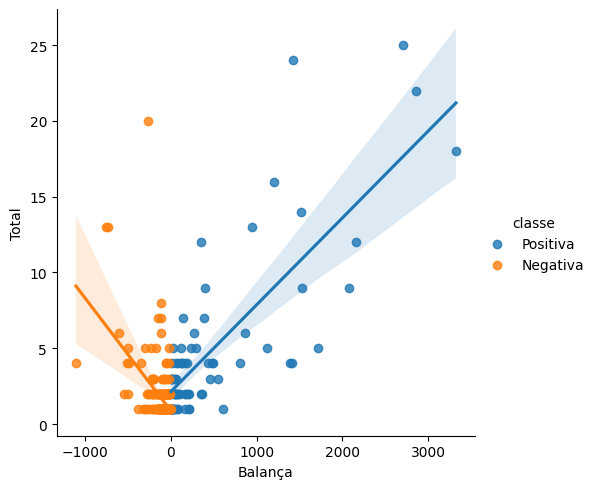

In [ ]:
sns.lmplot(x='Balança', y='Total', data=df_combined, hue='classe', fit_reg=True)

### Dual Mapa Plugin

In [ ]:
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)

In [ ]:
# Mesclar os DataFrames
df_deslocamento_maps = pd.merge(df_deslocamento, PopSp2022, left_on='Município', right_on='cod_ibge')
# Selecionar apenas as colunas desejadas
colunas_desejadas = ['Município', 'Residência', 'Internação','censo2022']
df_deslocamento_maps = df_deslocamento_maps[colunas_desejadas]
# Calcular a quantidade de médicos por cada mil habitantes
df_deslocamento_maps.iloc[:, 1:3] = df_deslocamento_maps.iloc[:, 1:3].astype(float)
df_deslocamento_maps.iloc[:, 1:3] = df_deslocamento_maps.iloc[:, 1:3].div((df_deslocamento_maps['censo2022'] / 1000), axis=0).round(2)
#df_deslocamento_maps = df_deslocamento_maps.replace(0, np.nan)

In [ ]:
df_deslocamento_maps_dict = df_deslocamento_maps.set_index('Município')

In [ ]:
plotDualMap(df_deslocamento_maps, 'Residência', 'Internação', 'legenda', df_deslocamento_maps_dict)

# **Dados Saúde - Internações por doenças Cardiovasculares / Cardiologistas - 2023**

In [ ]:
internações = pd.read_csv('doenças_cardio_internacao.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')
internações['Município'] = internações['Município'].str.replace('\D', '').str.replace(' ', '')
internações = internações.dropna(axis=0)
internações_dict = internações.set_index('Município')
cardiologista_dict = medicos.set_index('Município')

In [ ]:
cardiologista_dict.replace('0', np.nan, inplace=True)

In [ ]:
cardiologista_dict

In [ ]:
internações_dict

In [ ]:
df_combined

In [ ]:
df_combined = pd.merge(cardiologista_dict, internações_dict, on='Município')
#df_combined.dropna(inplace=True)
colunas = ['cardiologista', 'Internações']
df_combined = df_combined[colunas]
df_combined['cardiologista'] = df_combined['cardiologista'].astype(float)
df_combined['internacoes/cardiologista'] = df_combined['Internações'].div(df_combined['cardiologista'], axis=0).round(2)
df_combined.reset_index(inplace = True)
#df_combined.replace([np.inf, -np.inf], np.nan, inplace=True)
#df_combined['internacoes/cardiologista'].fillna(df_combined['Internações'], inplace=True)
df_combined_dict = df_combined.set_index('Município')

In [ ]:
plotMap(df_combined, 'Município', 'internacoes/cardiologista', 'Internações por cardiologista', df_combined_dict)

### Local de Residência

In [ ]:
internações_residencia = pd.read_csv('doenças_cardio_residencia.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')
internações_residencia['Município'] = internações_residencia['Município'].str.replace('\D', '').str.replace(' ', '')
internações_residencia = internações_residencia.dropna(axis=0)
internações_residencia_dict = internações_residencia.set_index('Município')
cardiologista_dict = medicos.set_index('Município')

<ipython-input-123-c89375b2ec3b>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  internações_residencia['Município'] = internações_residencia['Município'].str.replace('\D', '').str.replace(' ', '')


In [ ]:
df_combined_residencia = pd.merge(cardiologista_dict, internações_residencia_dict, on='Município', how='left')
df_combined.dropna(inplace=True)
colunas = ['cardiologista', 'Internações']
df_combined_residencia = df_combined_residencia[colunas]
df_combined_residencia['cardiologista'] = df_combined_residencia['cardiologista'].astype(float)
df_combined_residencia['internacoes/cardiologista'] = df_combined_residencia['Internações'].div(df_combined_residencia['cardiologista'], axis=0).round(2)
df_combined_residencia.reset_index(inplace = True)
df_combined_residencia.replace([np.inf, -np.inf], np.nan, inplace=True)
#df_combined['internacoes/cardiologista'].fillna(df_combined['Internações'], inplace=True)
df_combined_residencia_dict = df_combined_residencia.set_index('Município')

In [ ]:
plotMap(df_combined_residencia, 'Município', 'internacoes/cardiologista', 'Internações por cardiologista', df_combined_residencia_dict)

### Dual Map Plugin

In [ ]:
plotDualMap(df_combined, 'cardiologista', 'Internações', 'legenda', df_combined_dict)

# **Dados Saúde - Internações por doenças Endócrinas / Endocrinologista - 2023**

In [ ]:
internações = pd.read_csv('doenças_endocrinas_internacao.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')
internações['Município'] = internações['Município'].str.replace('\D', '').str.replace(' ', '')
internações = internações.dropna(axis=0)
internações_dict = internações.set_index('Município')
endocrinologista_dict = medicos.set_index('Município')

FileNotFoundError: ignored

In [ ]:
internações

,Município,Internações
0,350010,36.0
1,350030,8.0
2,350050,20.0
3,350070,3.0
4,350100,16.0
...,...,...
258,355630,4.0
259,355680,1.0
260,355700,36.0
261,355710,117.0


In [ ]:
df_combined = pd.merge(endocrinologista_dict, internações_dict, on='Município', how='left')
df_combined.dropna(inplace=True)
colunas = ['endocrinologista e metabologista', 'Internações']
df_combined = df_combined[colunas]
df_combined['endocrinologista e metabologista'] = df_combined['endocrinologista e metabologista'].astype(float)
df_combined['internacoes/endocrinologista'] = df_combined['Internações'].div(df_combined['endocrinologista e metabologista'], axis=0).round(2)
df_combined.reset_index(inplace = True)
df_combined.replace([np.inf, -np.inf], np.nan, inplace=True)
df_combined_dict = df_combined.set_index('Município')

NameError: ignored

In [ ]:
plotMap(df_combined, 'Município', 'internacoes/endocrinologista', 'Internações por endocrinologista', df_combined_dict)